# Lecture 3 - Sampling from other distributions

Reminder of what we have so far 
- We have a unif(0,1) number, and we want to be able to sample from any arbitary distribution
- Problems 1, 4, 5 cover last weeks material. 2 and 3 from today. 

## Method 1: CDF Inversion Method (Inverse Transform Sampling)
Assumptions
- suppose X discrete RV with outcomes $x_1 \dots x_n$ with probabilities $p_1 \dots p_n$
- we then know $p_n = 1- \sum p_i$

Process to generate sample from X:
- (1) Divide (0,1) into n subintervals as a partition: $I_1= [0, p_1), I_2 = [p_1, p_1 + p_2), I_3 = [p_1 + p_2, p_2 +p_3) \dots I_n =[\sum P_i , 1]$
- (2) Generate via psuedorandom process $U \sim Unif(0,1)$
- (3) Return $x_k$ where U lies in interval $I_k$

Intuition

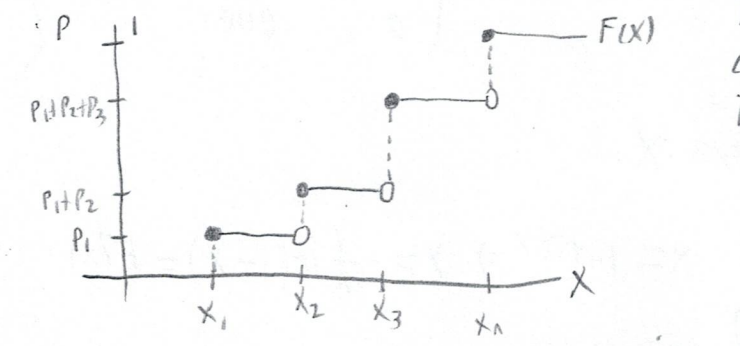

- This is a right continuous, monotonic, non-decreasing function (so it must have an inverse) 
- We see where U on the Y axis and see where it hits a vertical jump to see which bucket it falls into
- This leads into a Theorem

Theorem: 

- If $U \sim Unif(0, 1) \implies$ X = $F^{-1}(u)$ has cdf F(x)

Proof: 
$ P(X \leq x) = P( F^{-1}(u) \leq x)  \implies P(U \leq F(x) ) = F(x)$

## CDF Inversion Examples 
### (1: Discrete) Bernoulli Trials (biased coinflip) 

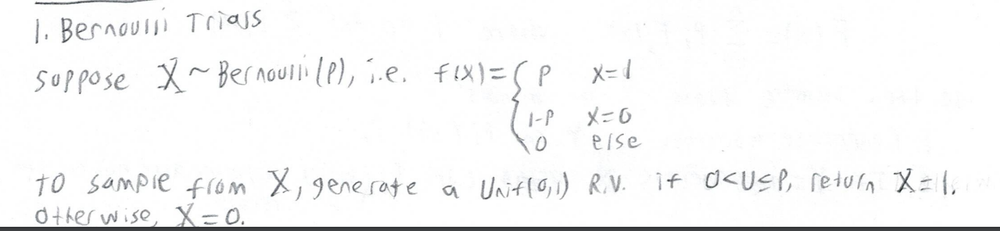

### (2: Discrete) Slot Machine Display 

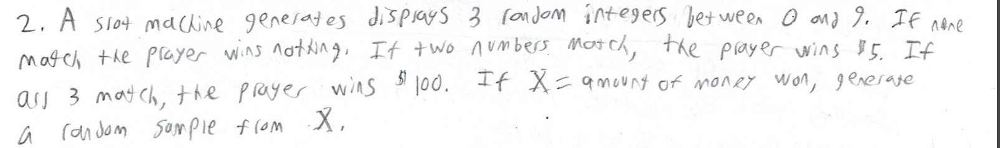

- first we calculate probability of outcomes, then we divide up into subintervals, then we can use it by generating a uniform(0,1) number and see which it goes into 
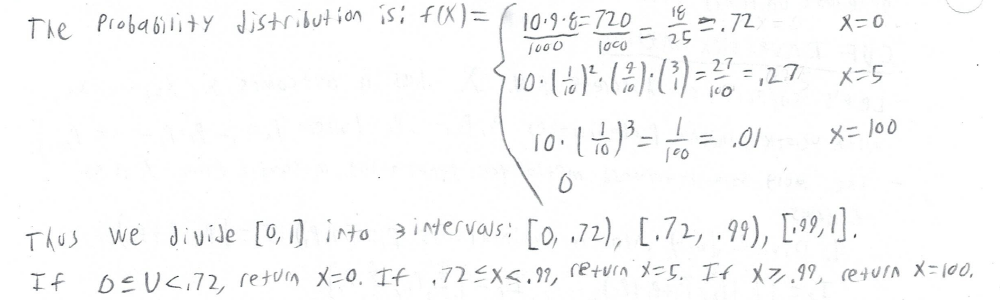

- note that the more intervals you have, the more comparisons you must do, but if we have something like this where the largest intervals are first, the more likely the comparisons will stop early
- You could probably do a binary search over these, since they are sorted, but that means really the best we can do is O(log2(m)) where m = the number of subintervals in the partition

### (3: Continuous) Exponential Distribution 

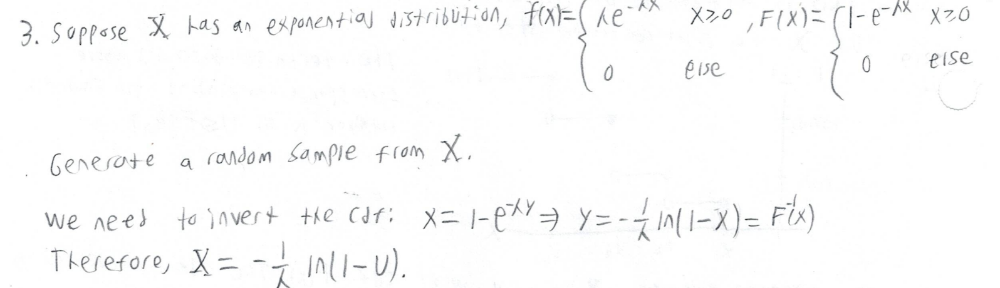

## Method 2: Composition Methods
Assumptions
- suppose we can break a CDF into several smaller components (writing it as a weighted sum) $F(x)  = \sum P_i F_i(x)$ where $F_i(x)$ are also have cdf properties 

Process to generate sample from X:
- (1) Generate a discrete random variable Y (picks which simpler cdf we want to use) where $P(Y=i) = P_i$
- (2) If Y=i, then generate X using CDF $F_i$ 

Derivation? 

- Defn: RVs $X_i$ with CDF $F_i$, let $I_{y=i} = \begin{cases} 1, y=i  \\ 0, otherwise \end{cases}$
- $X = \sum X_i I_{y=i} \implies P(X \leq x) \stackrel{LOTP}{=} \sum P(X \leq x | Y=i) \circ P(Y=i) = \sum P(X_i \leq x) P_i = \sum F_i(x) P_i$

Difficulties? 

- How do you break F into smaller F's

## Composition Method Example (The Alias Method for Discrete Random Variables) 

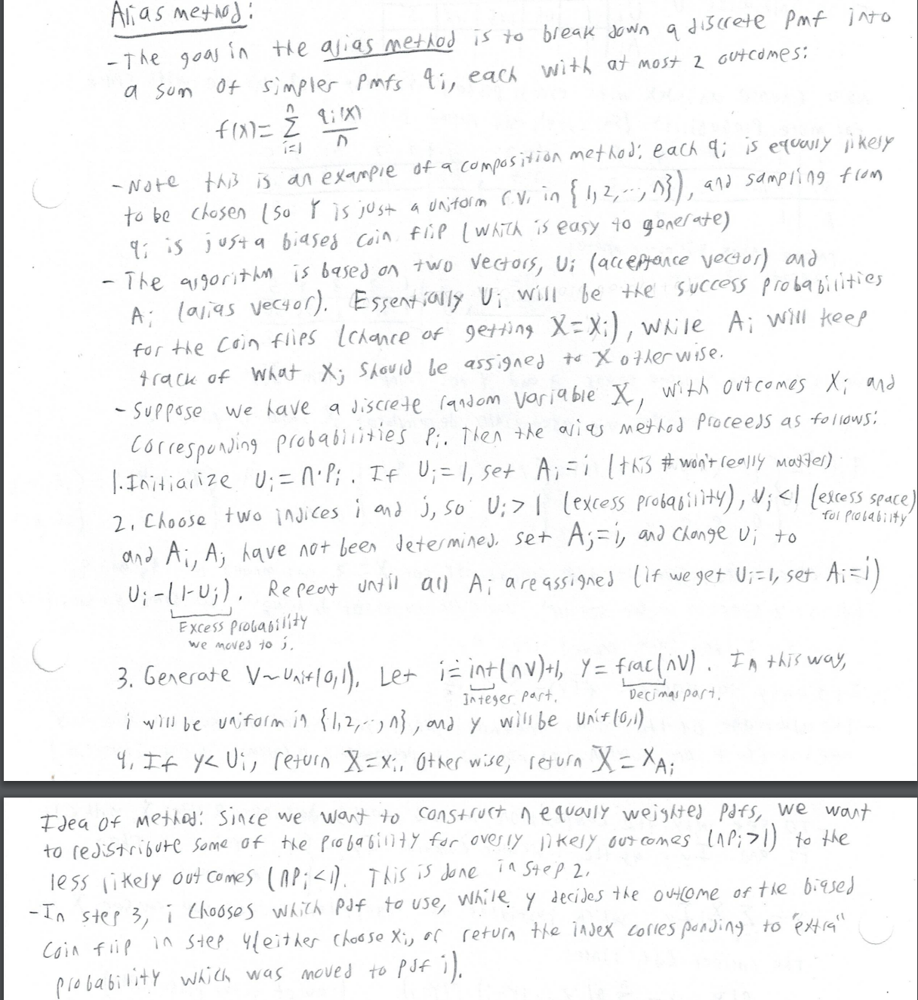

## Alias Method Practical Example

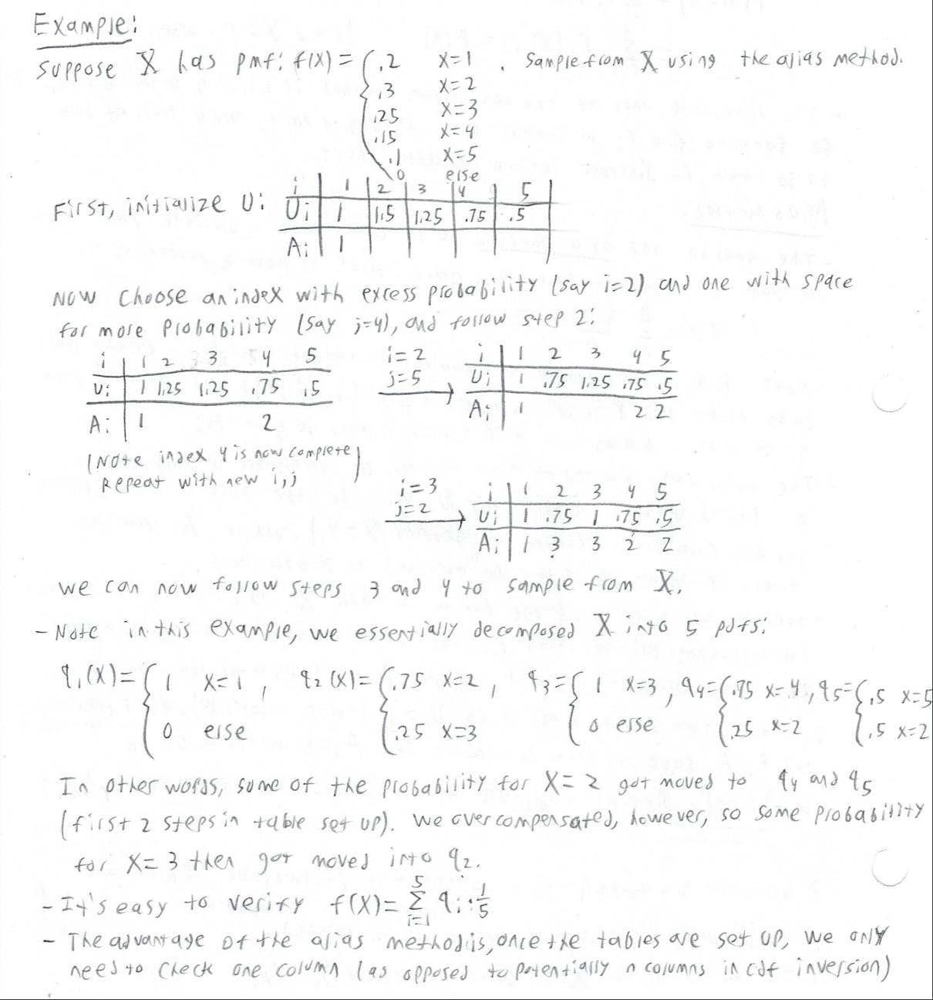

## Intuition
- Think of the Alias method almost like having some start up cost to build a hash table for us to do O(1) lookups of simpler CDFs, whereas the CDF inversion is doing a binary search on a partition that we assemble, we lose memory here, but gain inference speed 

# Lecture 4A - Code implementations of the Methods Above

## CDF Inversion Examples (discrete, then continuous) 

In [18]:
import numpy as np
import plotly.graph_objects as go

# Define the support of the discrete random variable and its probabilities
x_values = np.array([1, 2, 3, 4, 5])
p = np.array([0.2, 0.3, 0.25, 0.15, 0.1])

# Compute the cumulative distribution function (CDF) thresholds
thresholds = np.cumsum(p)  # [0.2, 0.5, 0.75, 0.9, 1.0]

# Set the sample size and generate uniform random numbers from U(0,1)
sample_size = 10000
U = np.random.uniform(0, 1, sample_size)

# Find the appropriate index for each random number by locating the first threshold not exceeded
indices = np.searchsorted(thresholds, U)

# Map the indices back to the values the random variable can take
samples = x_values[indices]

# Compute the frequency (and hence probability) for each unique value sampled
unique, counts = np.unique(samples, return_counts=True)
probabilities = counts / sample_size  # Normalized frequencies

# Create a bar chart using Plotly to display the probability distribution
fig = go.Figure(data=[go.Bar(x=unique,
                             y=probabilities,
                             marker_color='blue',
                             name="X")])
fig.update_layout(title="Histogram of Discrete Samples (10000 Samples)",
                  xaxis_title="x values",
                  yaxis_title="Probability")

fig.show()


In [19]:
import numpy as np
import plotly.graph_objects as go

# Parameters for the exponential distribution
L = 4  # Parameter in exponential distribution

# Define the inverse CDF function for the exponential distribution
def F_inv(x):
    return -1 / L * np.log(1 - x)

# Sample size
sample_size = 10000

# Generate uniform random numbers from U(0,1)
U = np.random.uniform(0, 1, sample_size)

# Apply the inverse CDF to generate samples from the exponential distribution
X = F_inv(U)

# Define the PDF of the exponential distribution
def f(x):
    return L * np.exp(-L * x)

# Generate x values for plotting the PDF
x = np.linspace(0, 3, 300)

# Create the histogram of samples (normalized to represent density)
histogram_data = np.histogram(X, bins=50, density=True)
bin_edges = histogram_data[1]
bin_centers = (bin_edges[:-1] + bin_edges[1:]) / 2  # Compute bin centers
density_values = histogram_data[0]

# Create Plotly figure
fig = go.Figure()

# Add histogram (density values)
fig.add_trace(go.Bar(x=bin_centers, y=density_values, name="X", marker_color="blue", opacity=0.7))

# Add PDF line
fig.add_trace(go.Scatter(x=x, y=f(x), mode="lines", name="PDF", line=dict(color="red")))

# Update layout for better visualization
fig.update_layout(title="Histogram and PDF of Exponential Distribution",
                  xaxis_title="x",
                  yaxis_title="Density",
                  legend_title="Legend")

fig.show()


## Alias Method Example 

In [21]:
import numpy as np
import plotly.graph_objects as go

# Define the discrete distribution
x_values = np.array([1, 2, 3, 4, 5])
p = np.array([0.2, 0.3, 0.25, 0.15, 0.1])
n = len(p)

# Setup phase for alias method
U = n * p.copy()  # List of acceptance probabilities (scaled by n)
A = np.arange(n)  # List of aliases (0-indexed for Python)

# Identify indices with excess and deficient probability
Over = [i for i in range(n) if U[i] > 1]  # Indices with excess probability
Under = [i for i in range(n) if U[i] < 1]  # Indices with deficient probability

# Redistribute probability mass following the algorithm
while len(Over) > 0:
    # Move excess probability from over-full index to under-full one
    A[Under[0]] = Over[0]
    U[Over[0]] = U[Over[0]] + U[Under[0]] - 1
    
    # This entry is now complete, remove it from the list
    Under.pop(0)
    
    # Check if the over-full entry needs reclassification
    if U[Over[0]] == 1:
        # This index is exactly full, so remove it
        Over.pop(0)
    elif U[Over[0]] <= 1:
        # This entry is now under-full, so move it to the proper list
        Under.insert(0, Over[0])
        Over.pop(0)

# Sampling phase
sample_size = 10000
V = np.random.uniform(0, 1, sample_size)
X = np.zeros(sample_size, dtype=int)

for i in range(sample_size):
    # Integer part of n*V[i], giving us the bin index
    index = int(np.floor(n * V[i]))
    
    # Fractional part of n*V[i], for the biased coin flip
    y = n * V[i] - index
    
    # Perform the biased coin flip
    if y < U[index]:
        X[i] = index  # Accept the primary value
    else:
        X[i] = A[index]  # Use the alias instead

# Map indices to actual x_values
samples = x_values[X]

# Create histogram with Plotly
unique, counts = np.unique(samples, return_counts=True)
probabilities = counts / sample_size

fig = go.Figure(data=[go.Bar(
    x=unique, 
    y=probabilities, 
    marker_color='blue', 
    name="X"
)])

fig.update_layout(
    title="Histogram of Discrete Samples using Alias Method (10000 Samples)",
    xaxis_title="x values",
    yaxis_title="Probability"
)

fig.show()


# Lecture 4B - Additional Method Theory 

## Method 1 - Acceptance Rejection Method (another composition method)
- Given some RV X with known pdf f(x), we want to generate a sample from it
- We want to look at another distribution with pdf g(x) where the following is true:
- (1) g is easier to sample from than f
- (2a) https://en.wikipedia.org/wiki/Support_(mathematics)
- (2b) $supp(f) \subseteq supp(g)$
- (3) Find constant $m>1$ st $f(x) \leq Mg(x) \forall x \in supp(f)$

Visual: 

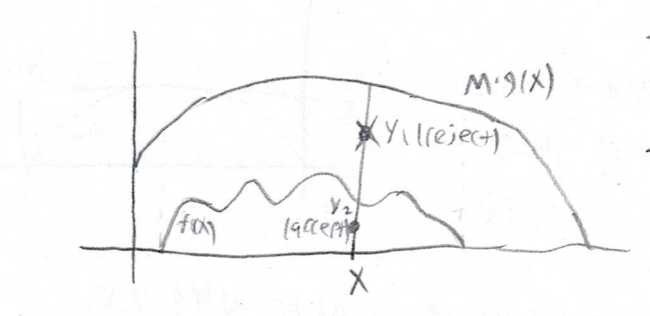

Here's the procedure: 

- (1) Geneate X using g(x) (via cdf inversion, etc...)
- (2) Generate $Y \sim unit(0, Mg(x))$
- (3) $Y > f(x) \implies$ reject point, return to (1). $Y \leq f(x) \implies$ return X as sample

Why does this work? 

- (1) Note that (x, y) is uniformly dist. on $A = \{ (x, y) \in \mathbb{R}^2 : 0 \leq y \leq Mg(x) \}$
- $f(x, y) = f_x(x) f_y(y | x) = g(x) \frac{1}{Mg(x)-0} = \frac{1}{M} = \frac{1}{\int_{-\infty}^{\infty}Mg(x)dx} = \frac{1}{Area(A)}$
- So it must be uniformly distributed over that area
- (2) Now note that accepted points $(x_*, y_*)$ are uniformly distributed on $B = \{ (x,y) \in \mathbb{R}^2: 0 \leq y \leq f(x) \}$
- $f_{x*} = \int_0^{f(x)} \frac{1}{Area(B)}dy = \int_0^{f(x)} \frac{1}{\int_{-\infty}^{\infty}f(x)dx}dy = f(x)$

Is it a good/efficient algorithm? 

- How efficient it is depends on the $P(rejection)=1-P(accepted)=1-\frac{Area(B)}{Area(A)}= 1-\frac{1}{M}$ which means M should be as close to 1 as possible to minimize P(rejection)

An example

- We could do cdf inversion, but inverse trig functions can be annoying so we'd rather not use that here 

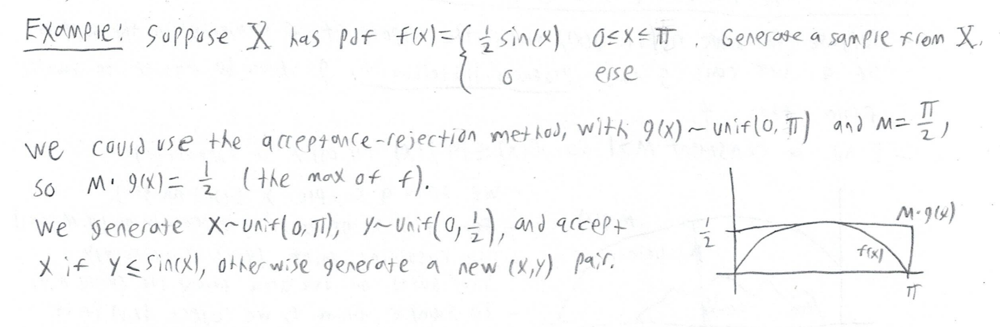

## Special Method 1 - For Binomial RVs (Bernoulli Trials) 
- We can't really do CDF inversion because of the trickiness of the equation 
- The Alias Method might be really costly
- Really a binomial RV is just a bunch of bernoulli trials, and bernoulli trails are really easy to generate 

Here's an approach

- If $X \sim Bernoulli(P) \implies f(x) = \{ P, x=1 ;;; 1-P, x=0 \}$
- If $X_k \sim Bernoulli(P)$ are IID(independent and identitically distributed) $\implies Y = \sum X_k \sim Bin(n, P)$

## Special Method 2 - For Normal RVs (Box Muller) 
- also kind of annoying to do CDF inversion
- We can really just generate uniform RVs and do some function evaluations 

Here's the approach 

- let $U_1, U_2 \sim Unif(0, 1)$
- $\implies X_1 = cos(2\pi, U_1) \sqrt{-2 \ln(U_2) }$
- $\implies X_1 = sin(2\pi, U_1) \sqrt{-2 \ln(U_2) }$
- You do a multivar change of variables to prove this 



# Lecture 4C - Code Implementation of New Methods 

## Acceptance Rejection Method Example 

In [22]:
import numpy as np
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Define the target PDF: f(x) = (1/2)*sin(x) for x in [0,π]
def f(x):
    # Using vectorized operations for efficiency
    return 0.5 * np.sin(x) * np.logical_and(0 <= x, x <= np.pi)

# Define the proposal distribution parameters
# Proposal is Uniform(0,π) with PDF g(x) = 1/π
# M is the constant such that M*g(x) ≥ f(x) for all x
M = np.pi/2  # The scaling factor

# Sample size
sample_size = 10000

# Initialize array and counter
X = np.zeros(sample_size)
count = 0  # Track total number of proposals

# Sampling loop
for i in range(sample_size):
    accepted = False
    while not accepted:
        count += 1
        # Sample from proposal distribution g(x) = Uniform(0,π)
        x = np.random.uniform(0, np.pi)
        # Sample from uniform distribution on [0, 1/2]
        y = np.random.uniform(0, 0.5)
        # Accept if y ≤ f(x)
        if y <= f(x):
            X[i] = x
            accepted = True

# Calculate acceptance probabilities
theoretical_acceptance_prob = 1/M
estimated_acceptance_prob = sample_size/count

print(f"Theoretical Acceptance Probability: {theoretical_acceptance_prob:.6f}")
print(f"Estimated Acceptance Probability: {estimated_acceptance_prob:.6f}")

# Create the visualization
# Compute histogram data
hist_data = np.histogram(X, bins=50, density=True)
bin_edges = hist_data[1]
bin_centers = (bin_edges[:-1] + bin_edges[1:]) / 2  # Center points for histogram bars
bin_heights = hist_data[0]

# Create the figure
fig = go.Figure()

# Add histogram as bars
fig.add_trace(go.Bar(
    x=bin_centers,
    y=bin_heights,
    name="X",
    marker_color="turquoise",
    opacity=0.7
))

# Add theoretical PDF curve
x_curve = np.linspace(0, 3.2, 100)  # Define x points for the curve
fig.add_trace(go.Scatter(
    x=x_curve,
    y=f(x_curve),
    mode="lines",
    name="PDF",
    line=dict(color="red", width=2)
))

# Update layout
fig.update_layout(
    title="Sampling from f(x) = (1/2)sin(x) using Acceptance-Rejection Method",
    xaxis_title="x",
    yaxis_title="Density",
    legend=dict(
        yanchor="top",
        y=0.99,
        xanchor="right",
        x=0.99
    )
)

fig.show()


Theoretical Acceptance Probability: 0.636620
Estimated Acceptance Probability: 0.640533


## Bernoulli Simulations Example 

In [27]:
import numpy as np
import plotly.graph_objects as go

# Parameters
p = 0.5  # Success probability
N = 10   # Number of trials
sample_size = 10000

U = np.random.uniform(0, 1, (sample_size, N))
X = np.sum(U <= p, axis=1)

# Count occurrences of each value and convert to probabilities
unique, counts = np.unique(X, return_counts=True)
probabilities = counts / sample_size

# Create the visualization
fig = go.Figure(data=[go.Bar(
    x=unique, 
    y=probabilities,
    marker_color='turquoise',
    name="X"
)])

fig.update_layout(
    title="Histogram of Simulated Binomial(10, 0.5) Random Variables",
    xaxis_title="Number of Successes",
    yaxis_title="Probability",
    xaxis=dict(
        tickmode='linear', 
        tick0=0, 
        dtick=1  # Force integer ticks
    )
)

fig.show()


## Box-Muller Example 

In [28]:
import numpy as np
import plotly.graph_objects as go

# Parameters
sample_size = 50000  # Half the final sample size since each pair generates two normal RVs

# Generate uniform random variables
U1 = np.random.uniform(0, 1, sample_size)
U2 = np.random.uniform(0, 1, sample_size)

# Apply Box-Muller transform
X = np.zeros(2 * sample_size)
for i in range(sample_size):
    X[2*i] = np.cos(2*np.pi*U1[i]) * np.sqrt(-2*np.log(U2[i]))
    X[2*i+1] = np.sin(2*np.pi*U1[i]) * np.sqrt(-2*np.log(U2[i]))

# Alternative vectorized implementation:
# X1 = np.cos(2*np.pi*U1) * np.sqrt(-2*np.log(U2))
# X2 = np.sin(2*np.pi*U1) * np.sqrt(-2*np.log(U2))
# X = np.concatenate([X1, X2])

# Standard normal PDF function
def f(x):
    return 1/np.sqrt(2*np.pi) * np.exp(-x**2/2)

# Create histogram
hist_data = np.histogram(X, bins=100, density=True)
bin_edges = hist_data[1]
bin_centers = (bin_edges[:-1] + bin_edges[1:]) / 2
bin_heights = hist_data[0]

# Create figure
fig = go.Figure()

# Add histogram as bars
fig.add_trace(go.Bar(
    x=bin_centers,
    y=bin_heights,
    name="X",
    marker_color="turquoise",
    opacity=0.7
))

# Add theoretical PDF curve
x_curve = np.linspace(-4, 4, 100)
fig.add_trace(go.Scatter(
    x=x_curve,
    y=f(x_curve),
    mode="lines",
    name="PDF",
    line=dict(color="red", width=2)
))

# Update layout
fig.update_layout(
    title="Standard Normal RVs generated with Box-Muller Transform",
    xaxis_title="x",
    yaxis_title="Density"
)

fig.show()
